#### PROJECT GOAL 
- The Goal of the  Project is that given a dataset containing information regarding weather data , can we find the best classification Model to determine  **Wether it will rain tommorrow**

### Data Source 
- The dataset description comprises of regular weather observations from various Weather Australian Stations over aa period of 10 years 

In [1]:
## Dataframe Manipulation
import matplotlib
import numpy as np
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
### Importing Neccessary Libraries 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import QuantileTransformer
from scipy.cluster.hierarchy import dendrogram, linkage
from collections import Counter
# balance data
from imblearn import under_sampling, over_sampling
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
# Machine Learning (Scikit-learn Estimators, Catboost, LightGBM, etc. )
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier, plot_importance
from sklearn.metrics import roc_curve
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
# Hyperparameters Fine-tuning (Scikit-learn hp search, cross-validation, etc. )
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import KFold
from sklearn.metrics import make_scorer, fbeta_score
# Evaluations
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV, cross_val_score
from statistics import stdev
from sklearn.model_selection import KFold
## Pandas Profiler 
from ydata_profiling import ProfileReport
## missing values 
from verstack import NaNImputer
## statiscal Analysis 
from scipy.stats import ttest_ind , f_oneway
import pingouin as pg
pd.set_option('display.max_columns',None)
# matplotlib.use('TkAgg')
%matplotlib inline
import plotly.express as px 
colors_list_qualitative = px.colors.qualitative.T10
colors_list_sequential = px.colors.sequential.YlGn




In [2]:
##loading the data 
weather_data = pd.read_csv(r'd:\JT_analytics\datasets\WeatherUs\weatherAUS.csv')

In [3]:
## displaying the first five rows  
weather_data.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No


In [4]:
## checking the last five rows 
weather_data.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
142188,2017-06-20,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,No,0.0,No
142189,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,0.0,No
142190,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,0.0,No
142191,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,0.0,No
142192,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,0.0,No


In [5]:
### checking the shape of the data  
weather_data.shape

(142193, 24)

In [6]:
## checking for data type inconsistences
weather_data.info()
## short notes 
# - the date column is of wrong data type 
# - they are missing values 
# -
## convert month to date time format 
weather_data['Date'] = pd.to_datetime(weather_data['Date'])


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 142193 entries, 0 to 142192
Data columns (total 24 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           142193 non-null  object 
 1   Location       142193 non-null  object 
 2   MinTemp        141556 non-null  float64
 3   MaxTemp        141871 non-null  float64
 4   Rainfall       140787 non-null  float64
 5   Evaporation    81350 non-null   float64
 6   Sunshine       74377 non-null   float64
 7   WindGustDir    132863 non-null  object 
 8   WindGustSpeed  132923 non-null  float64
 9   WindDir9am     132180 non-null  object 
 10  WindDir3pm     138415 non-null  object 
 11  WindSpeed9am   140845 non-null  float64
 12  WindSpeed3pm   139563 non-null  float64
 13  Humidity9am    140419 non-null  float64
 14  Humidity3pm    138583 non-null  float64
 15  Pressure9am    128179 non-null  float64
 16  Pressure3pm    128212 non-null  float64
 17  Cloud9am       88536 non-null

In [7]:
### checking for missing values  
weather_data.isnull().mean()*100

Date              0.000000
Location          0.000000
MinTemp           0.447983
MaxTemp           0.226453
Rainfall          0.988797
Evaporation      42.789026
Sunshine         47.692924
WindGustDir       6.561504
WindGustSpeed     6.519308
WindDir9am        7.041838
WindDir3pm        2.656952
WindSpeed9am      0.948007
WindSpeed3pm      1.849599
Humidity9am       1.247600
Humidity3pm       2.538803
Pressure9am       9.855619
Pressure3pm       9.832411
Cloud9am         37.735332
Cloud3pm         40.152469
Temp9am           0.635756
Temp3pm           1.917113
RainToday         0.988797
RISK_MM           0.000000
RainTomorrow      0.000000
dtype: float64

##### Notes 
- Many columns have missing values, requiring careful selection of handling strategies to avoid compromising data quality.
- For continuous variables, regression-based imputation may be more effective than simple strategies like mean, median, or mode imputation.
- Columns with over 40% missingness (e.g., Evaporation, Sunshine) should typically be removed unless deemed critical based on domain knowledge or their importance in predictive modeling.
- Retaining columns with high missingness can introduce bias during training if not handled properly.
- For categorical features with missing values (e.g., WindGustDir), i try to consider mode imputation, KNN, or other appropriate methods.
- we shall implement the iterativeImputer in the later stages to handle missingness
- for high missing percentages we shall check correlation with the target variable to see how they  correelate before deleting it

In [8]:
# checking for duplicates 
weather_data.duplicated(keep='first').sum()
#-  they are no duplicates in the data so we proceed

0

In [9]:
weather_data.drop_duplicates(keep='first',inplace=True)

In [10]:
# - checking for descriptive statistics 
print('Numeric Descriptive statistics')
print('-------------------------------------------------------------------------------------------------------------')
weather_data.describe().T

Numeric Descriptive statistics
-------------------------------------------------------------------------------------------------------------


,count,mean,min,25%,50%,75%,max,std
Date,142193,2013-04-01 00:28:51.730816512,2007-11-01 00:00:00,2011-01-06 00:00:00,2013-05-27 00:00:00,2015-06-12 00:00:00,2017-06-25 00:00:00,NaN
MinTemp,141556.0,12.1864,-8.5,7.6,12.0,16.8,33.9,6.403283
MaxTemp,141871.0,23.226784,-4.8,17.9,22.6,28.2,48.1,7.117618
Rainfall,140787.0,2.349974,0.0,0.0,0.0,0.8,371.0,8.465173
Evaporation,81350.0,5.469824,0.0,2.6,4.8,7.4,145.0,4.188537
Sunshine,74377.0,7.624853,0.0,4.9,8.5,10.6,14.5,3.781525
WindGustSpeed,132923.0,39.984292,6.0,31.0,39.0,48.0,135.0,13.588801
WindSpeed9am,140845.0,14.001988,0.0,7.0,13.0,19.0,130.0,8.893337
WindSpeed3pm,139563.0,18.637576,0.0,13.0,19.0,24.0,87.0,8.803345
Humidity9am,140419.0,68.84381,0.0,57.0,70.0,83.0,100.0,19.051293


### Key Findings from the Numeric descriptive statistics
* Temperature is likely a strong predictor as extremes (very low or high temperatures) could correlate with rainfall patterns.
* Significant differences between MinTemp and MaxTemp indicate daily temperature variation, which may also influence rainfall.
* Rainfall is highly skewed, with 75% of the days recording ≤ 0.8 mm of rainfall.
* Maximum rainfall is 371.0 mm, which indicates occasional extreme rainfall events.
* The average gust speed is 39.98 km/h, with a maximum of 135 km/h.
* Winds are generally stronger in the afternoon.
* High wind speeds may precede or accompany rainy conditions, making them an important variable for prediction.
* Mornings are generally more humid than afternoons.

In [11]:
# - checking for categorical variables 
print('Categorical objects')
print('-----------------------------------------------------------------------------------------------------------------')
weather_data.describe(include=['object','category']).T

Categorical objects
-----------------------------------------------------------------------------------------------------------------


,count,unique,top,freq
Location,142193,49,Canberra,3418
WindGustDir,132863,16,W,9780
WindDir9am,132180,16,N,11393
WindDir3pm,138415,16,SE,10663
RainToday,140787,2,No,109332
RainTomorrow,142193,2,No,110316


#### - Leveraging the Profiler for Deeper Data Insights
* We will utilize the profiler to gain comprehensive insights into our dataset, uncovering detailed information that will enhance our understanding and drive more informed decisions.

In [12]:
# importing the profiler 
from ydata_profiling import ProfileReport
profile_report =  ProfileReport(
    weather_data,
    title="Weather Data Profile Report",
    minimal=False,
    explorative=True,


)

profile_report.to_notebook_iframe()

# profile_report.to_file('weather_data.html')


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Numeric Distribution 

In [13]:
# print(weather_data.index.duplicated().any().sum())  # True if duplicates exist


In [14]:
# 


In [15]:
# print(weather_data.index.duplicated().any().sum()) 

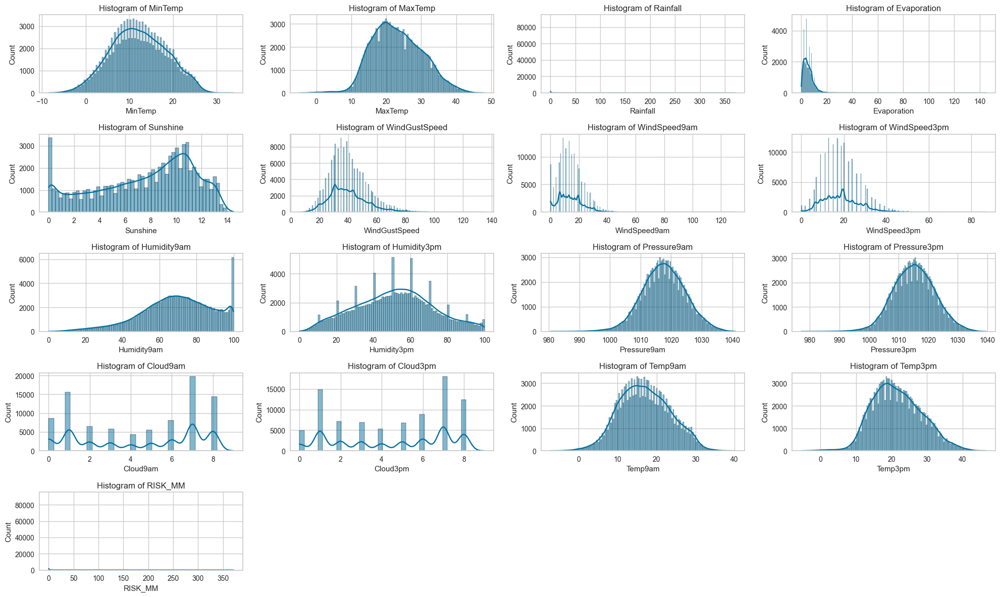

In [16]:
 # Selecting numeric columns
numeric_columns = weather_data.select_dtypes(include='float64').columns

# Setting up the grid for subplots
num_cols = 4
num_rows = int(np.ceil(len(numeric_columns) / num_cols))
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 12))

# Flattening the axes for easy iteration
axes = axes.flatten()

# Plotting histograms for each numeric column
for i, column in enumerate(numeric_columns):
    sns.histplot(data=weather_data, x=column, kde=True, ax=axes[i])
    axes[i].set_title(f'Histogram of {column}')

# Hiding unused subplots (if any)
for j in range(len(numeric_columns), len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()

### key insights 
* Rainfall and RISK_MM: Both distributions are heavily skewed towards zero, indicating a lot of dry days. This aligns with the need for a balanced approach when modeling, as your dataset likely has an imbalance in "rainy" versus "non-rainy" days.
* MinTemp and MaxTemp: These show a roughly normal distribution, making them solid candidates for predictive features. They can be further enriched by understanding seasonal trends or anomalies.
* Sunshine: This is interesting because it’s bimodal with some spikes, indicating clusters of clear and overcast days. Low sunshine might strongly correlate with rainy outcomes.
* Humidity (9am and 3pm): Both are skewed towards higher values. Higher humidity, especially in the morning, is a known indicator of rain and should definitely be a feature to prioritize.
* WindGustSpeed and WindSpeed (9am and 3pm): These are right-skewed, and peaks in the mid-range speeds might be tied to stormy or rainy weather conditions. Investigate their relationship with rainfall.
* Evaporation: It has a sharp skew, suggesting days with minimal evaporation dominate. Less evaporation could correlate with higher chances of rain, as the ground stays wetter.

##### OUTLIER ANALYSIS

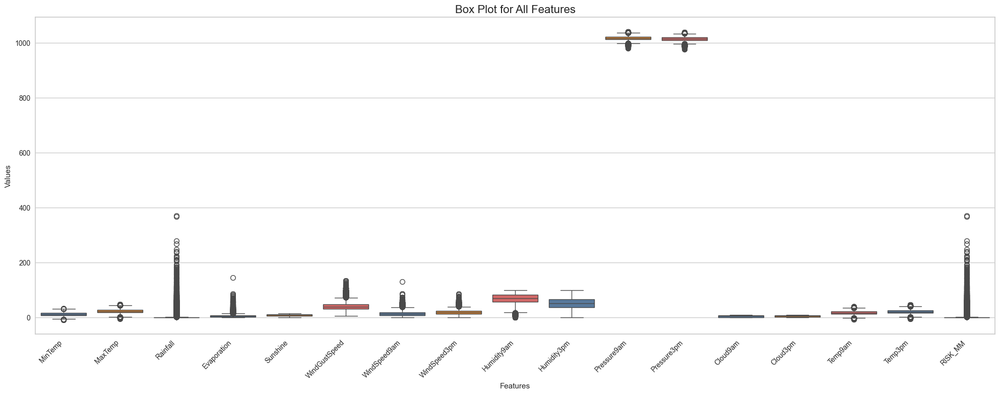

In [17]:
### OUTLIER ANALYSIS

# Creating a boxplot with logarithmic scale for the y-axis
plt.figure(figsize=(20, 8))
ax = sns.boxplot(data=weather_data, palette=colors_list_qualitative[:3])

# Set plot title and labels
plt.title('Box Plot for All Features', fontsize=16)
plt.xlabel('Features')
plt.ylabel('Values')

# Set y-axis to logarithmic scale
# ax.set_yscale('log')

# Improve layout
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save and show plot
plt.show()



#### Checking for the Outliers in the Numeric Columns

In [18]:
# Count extreme outliers (beyond 99th percentile) for key features
for col in weather_data.select_dtypes(include='float64').columns:
    upper_limit = weather_data[col].quantile(0.99)
    outliers = (weather_data[col] > upper_limit).sum()
    print(f"{col}: {outliers} extreme outliers")


MinTemp: 1316 extreme outliers
MaxTemp: 1409 extreme outliers
Rainfall: 1400 extreme outliers
Evaporation: 793 extreme outliers
Sunshine: 584 extreme outliers
WindGustSpeed: 1074 extreme outliers
WindSpeed9am: 1309 extreme outliers
WindSpeed3pm: 1272 extreme outliers
Humidity9am: 0 extreme outliers
Humidity3pm: 821 extreme outliers
Pressure9am: 1232 extreme outliers
Pressure3pm: 1263 extreme outliers
Cloud9am: 2 extreme outliers
Cloud3pm: 1 extreme outliers
Temp9am: 1378 extreme outliers
Temp3pm: 1361 extreme outliers
RISK_MM: 1418 extreme outliers


In [19]:
# Check relationship between RainToday and RainTomorrow
rain_today = weather_data.groupby('RainToday')['RainTomorrow'].value_counts(normalize=True).unstack()
print(rain_today)


RainTomorrow        No       Yes
RainToday                       
No            0.848132  0.151868
Yes           0.535940  0.464060


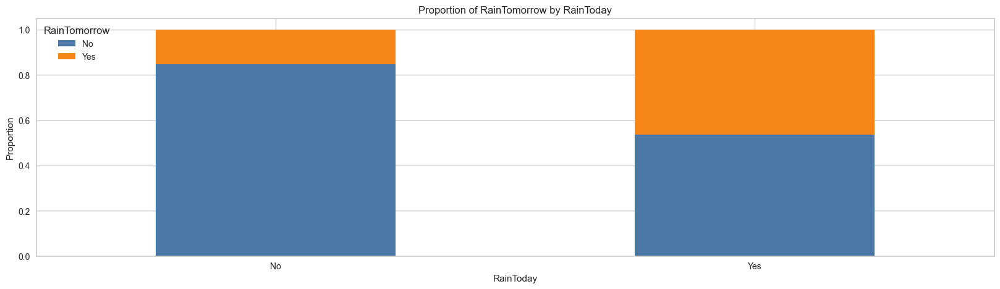

In [20]:

# Proportion of RainTomorrow by RainToday
rain_today_plot = weather_data.groupby('RainToday')['RainTomorrow'].value_counts(normalize=True).unstack()

rain_today_plot.plot(kind='bar', stacked=True, figsize=(20, 5), color=colors_list_qualitative[:2])
plt.title('Proportion of RainTomorrow by RainToday')
plt.ylabel('Proportion')
plt.xlabel('RainToday')
plt.xticks(rotation=0)
plt.legend(title='RainTomorrow', loc='upper left')
plt.show()


### key Insights 
- The proportion of RainTomorrow = Yes is higher compared to the "RainToday = No" group, but RainTomorrow = No still dominates.
- RainToday appears to have a strong influence on RainTomorrow and could be a valuable feature for predicting rainfall.


In [21]:
# Compare average Humidity and Cloud cover by RainTomorrow
humidity_cloud_avg = weather_data.groupby('RainTomorrow')[['Humidity3pm', 'Cloud3pm']].mean()
print(humidity_cloud_avg)


              Humidity3pm  Cloud3pm
RainTomorrow                       
No              46.510625  3.921896
Yes             68.800019  6.360065


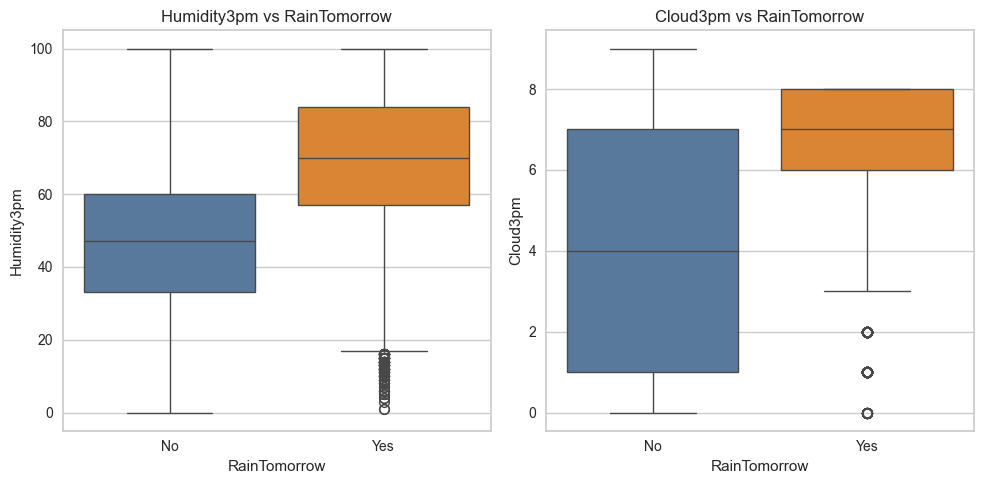

In [22]:
# Boxplots to show distribution of Humidity3pm and Cloud3pm
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
sns.boxplot(x='RainTomorrow', y='Humidity3pm', data=weather_data, palette=colors_list_qualitative[:2])
plt.title('Humidity3pm vs RainTomorrow')
plt.xlabel('RainTomorrow')
plt.ylabel('Humidity3pm')

plt.subplot(1, 2, 2)
sns.boxplot(x='RainTomorrow', y='Cloud3pm', data=weather_data, palette=colors_list_qualitative[:2])
plt.title('Cloud3pm vs RainTomorrow')
plt.xlabel('RainTomorrow')
plt.ylabel('Cloud3pm')

plt.tight_layout()
plt.show()


In [23]:
# Analyze RainTomorrow probability by Location
regional_rain = weather_data.groupby('Location')['RainTomorrow'].value_counts(normalize=True).unstack()
print(regional_rain.head())


RainTomorrow         No       Yes
Location                         
Adelaide       0.777346  0.222654
Albany         0.700928  0.299072
Albury         0.794753  0.205247
AliceSprings   0.919499  0.080501
BadgerysCreek  0.800888  0.199112


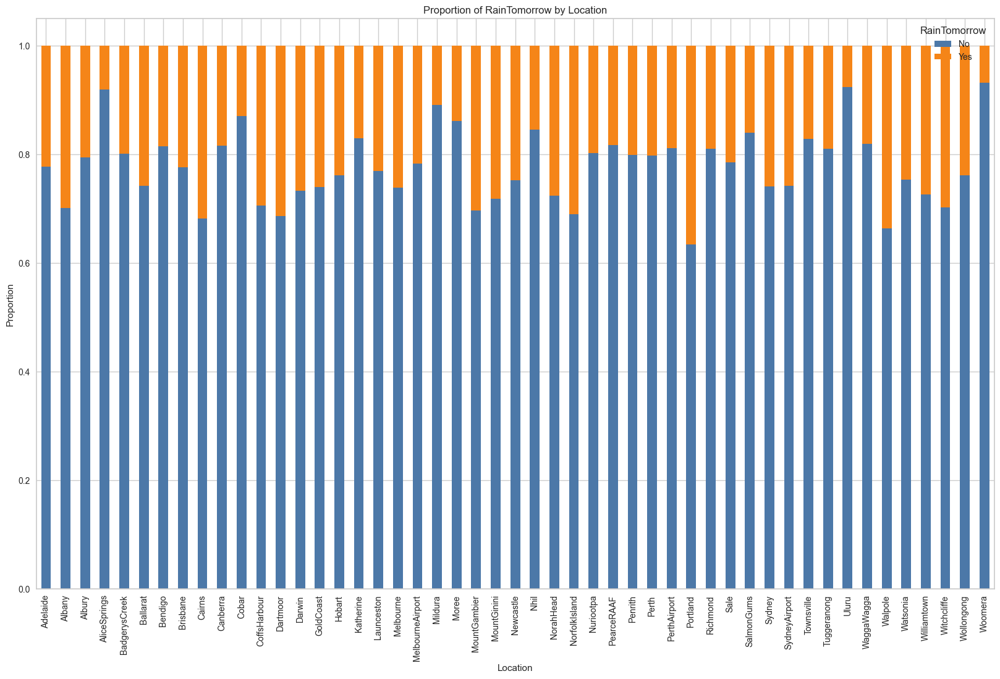

In [24]:
# Barplot for regional rain proportions
regional_rain = weather_data.groupby('Location')['RainTomorrow'].value_counts(normalize=True).unstack()

regional_rain.plot(kind='bar', stacked=True, figsize=(20, 12), color=colors_list_qualitative[:2])
plt.title('Proportion of RainTomorrow by Location')
plt.ylabel('Proportion')
plt.xlabel('Location')
plt.xticks(rotation=90)
plt.legend(title='RainTomorrow', loc='upper right')
plt.show()


In [25]:
weather_data.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RISK_MM', 'RainTomorrow'],
      dtype='object')

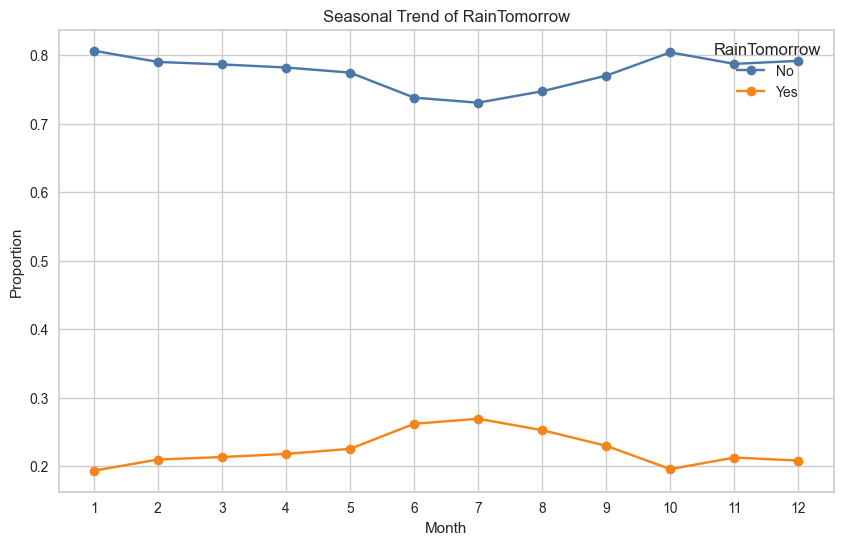

In [26]:
# Lineplot for RainTomorrow proportion by Month
# weather_data['Date'] = pd.to_datetime(weather_data['Date'])
weather_data['Month'] = weather_data['Date'].dt.month

seasonal_rain = weather_data.groupby('Month')['RainTomorrow'].value_counts(normalize=True).unstack()

seasonal_rain.plot(kind='line', figsize=(10, 6), marker='o', color=colors_list_qualitative[:2])
plt.title('Seasonal Trend of RainTomorrow')
plt.ylabel('Proportion')
plt.xlabel('Month')
plt.xticks(range(1, 13))
plt.legend(title='RainTomorrow', loc='upper right')
plt.show()


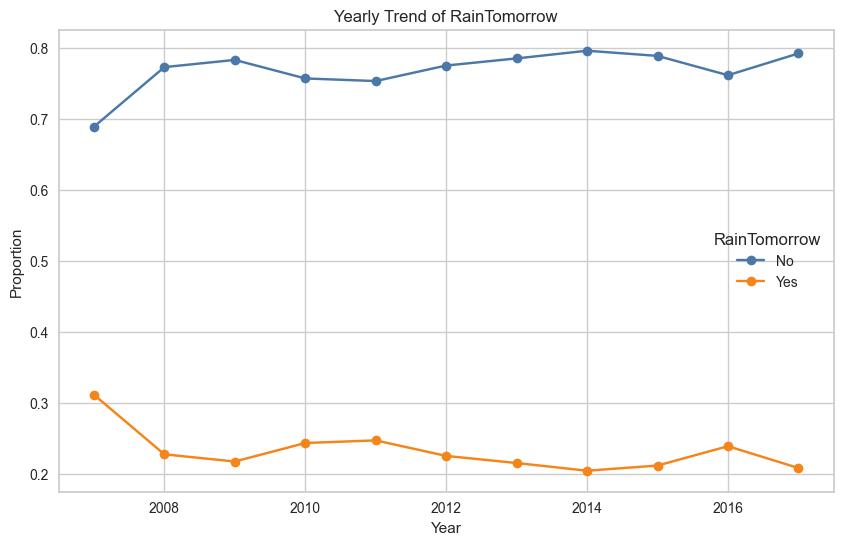

In [27]:
# Extract year and month from Date
weather_data['Year'] = weather_data['Date'].dt.year
weather_data['Month'] = weather_data['Date'].dt.month

# Group by year and calculate the proportion of RainTomorrow
yearly_trend = weather_data.groupby('Year')['RainTomorrow'].value_counts(normalize=True).unstack()

# Plot yearly trend
yearly_trend.plot(kind='line', figsize=(10, 6), marker='o', color=colors_list_qualitative[:2])
plt.title('Yearly Trend of RainTomorrow')
plt.ylabel('Proportion')
plt.xlabel('Year')
plt.legend(title='RainTomorrow')
plt.show()


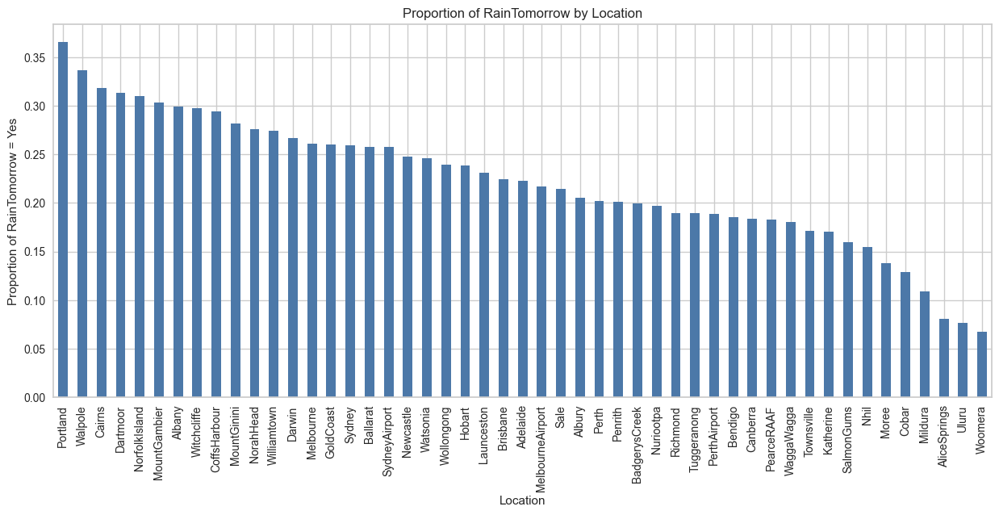

In [28]:
# Calculate proportion of RainTomorrow by Location
location_trend = weather_data.groupby('Location')['RainTomorrow'].value_counts(normalize=True).unstack()

# Sort and plot
location_trend.sort_values(by='Yes', ascending=False, inplace=True)
location_trend['Yes'].plot(kind='bar', figsize=(15, 6), color=colors_list_qualitative[:1])
plt.title('Proportion of RainTomorrow by Location')
plt.ylabel('Proportion of RainTomorrow = Yes')
plt.xlabel('Location')
plt.xticks(rotation=90)
plt.show()


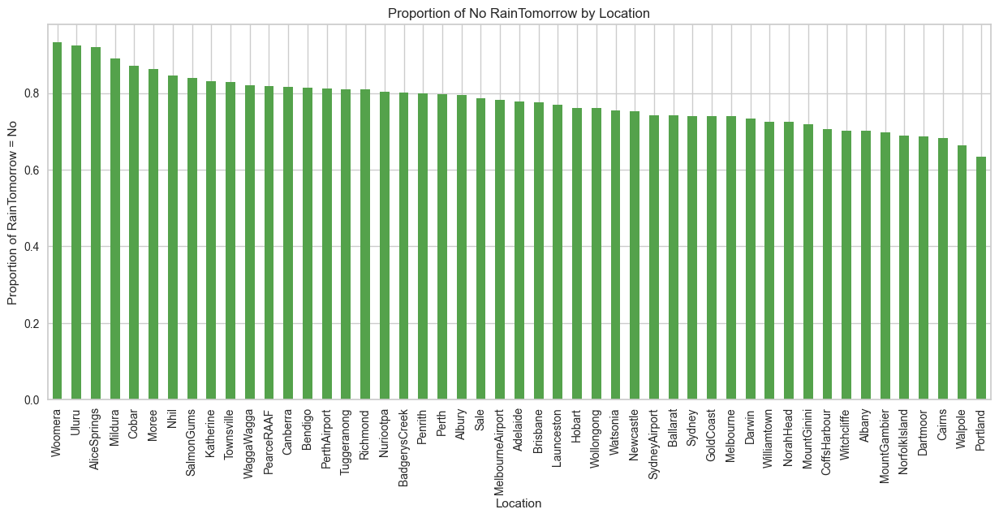

In [29]:
# Calculate proportion of RainTomorrow by Location
location_trend = weather_data.groupby('Location')['RainTomorrow'].value_counts(normalize=True).unstack()

# Sort and plot
location_trend.sort_values(by='No', ascending=False, inplace=True)
location_trend['No'].plot(kind='bar', figsize=(15, 6), color=colors_list_qualitative[4])
plt.title('Proportion of No RainTomorrow by Location')
plt.ylabel('Proportion of RainTomorrow = No')
plt.xlabel('Location')
plt.xticks(rotation=90)
plt.show()


In [30]:
import pandas as pd
import pingouin as pg


# Filter for relevant columns (numerical features)
numerical_features = weather_data.select_dtypes(include=['float64']).columns.tolist()

# Loop through numerical features and perform the test
results = []
for feature in numerical_features:
    # Perform t-test or Mann-Whitney U test
    stat_test = pg.ttest(weather_data[weather_data['RainTomorrow'] == 'Yes'][feature], 
                         weather_data[weather_data['RainTomorrow'] == 'No'][feature])
    
    # Append results
    results.append({
        'Feature': feature,
        'T-Statistic': stat_test['T'].values[0],
        'P-Value': stat_test['p-val'].values[0],
        'Difference (Yes - No)': stat_test['cohen-d'].values[0]
    })


In [31]:

# Convert results to DataFrame for easy viewing
results_df = pd.DataFrame(results)
results_df['Significant'] = results_df['P-Value'] < 0.05

# Display results
print(results_df)


          Feature  T-Statistic        P-Value  Difference (Yes - No)  \
0         MinTemp    31.914483  2.348374e-221               0.202049   
1         MaxTemp   -61.467943   0.000000e+00               0.386682   
2        Rainfall    58.948729   0.000000e+00               0.592692   
3     Evaporation   -38.764391   0.000000e+00               0.290245   
4        Sunshine  -138.187848   0.000000e+00               1.207085   
5   WindGustSpeed    77.045277   0.000000e+00               0.579673   
6    WindSpeed9am    32.318678  1.151762e-226               0.219191   
7    WindSpeed3pm    30.396165  6.410961e-201               0.211612   
8     Humidity9am   109.263109   0.000000e+00               0.639073   
9     Humidity3pm   182.607693   0.000000e+00               1.197511   
10    Pressure9am   -87.218386   0.000000e+00               0.609252   
11    Pressure3pm   -79.131834   0.000000e+00               0.556235   
12       Cloud9am   114.209649   0.000000e+00               0.79

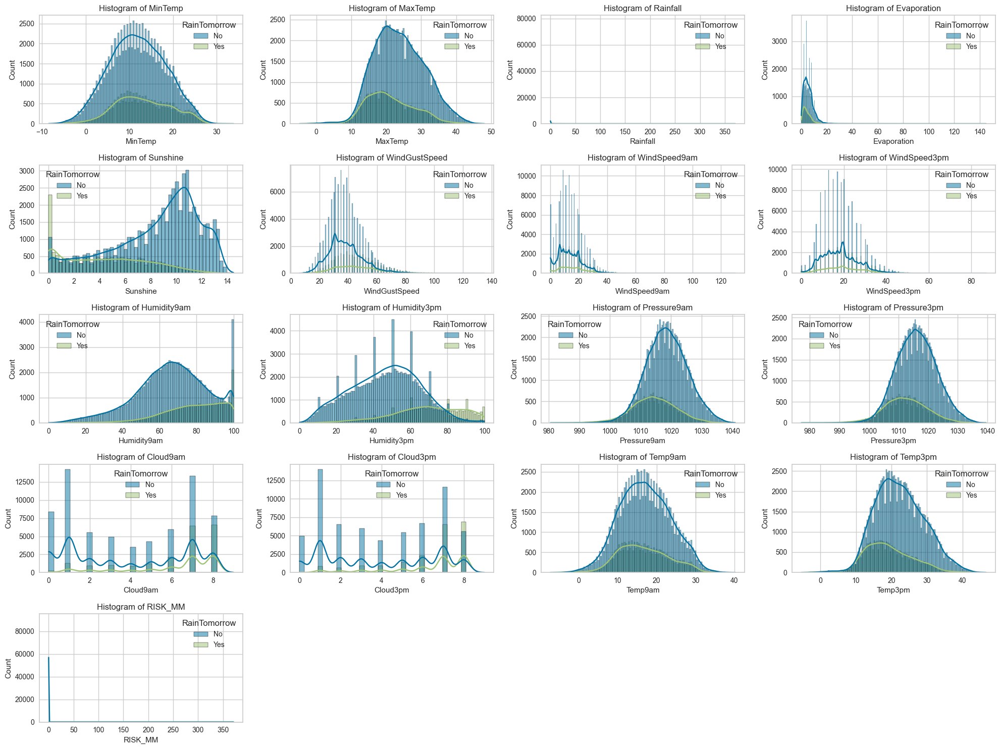

In [32]:
numeric_columns = list(weather_data.select_dtypes(include=['float']).columns)
# numeric_columns.remove('Month')
# Calculate the grid size
n_cols = 4
n_rows = int(np.ceil(len(numeric_columns) / n_cols))
# Create subplots
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes = axes.flatten() # Flatten to easily index axes
# Plot each histogram
for i, column in enumerate(numeric_columns):
    sns.histplot(data=weather_data, x=column, hue='RainTomorrow', alpha=0.5, kde=True, ax=axes[i])
    axes[i].set_title(f'Histogram of {column}')
    axes[i].set_xlabel(column)
    axes[i].set_ylabel('Count')
# Hide any empty subplots (in case number of columns doesn't divide evenly)
for j in range(i + 1, n_rows * n_cols):
    axes[j].axis('off')
# Adjust layout for better spacing
plt.tight_layout()

In [33]:
import pingouin as pg

# Selecting a few numerical weather features
weather_features = ['Rainfall', 'Humidity3pm', 'Pressure3pm', 'WindGustSpeed', 'Temp3pm','Evaporation','Sunshine','Cloud9am','Cloud3pm']

# Encode target variable (RainTomorrow: Yes=1, No=0)
weather_data['RainTomorrow_enc'] = weather_data['RainTomorrow'].map({'Yes': 1, 'No': 0})

# Calculate correlations using Pingouin
correlations = (
    weather_data[weather_features + ['RainTomorrow_enc']]
    .corr(method='pearson')
    .loc[weather_features, 'RainTomorrow_enc']
    .sort_values(ascending=False)
)

# Display the correlations
print("Correlation of Weather Features with RainTomorrow:")
print(correlations)


Correlation of Weather Features with RainTomorrow:
Humidity3pm      0.446160
Cloud3pm         0.381870
Cloud9am         0.317380
Rainfall         0.239032
WindGustSpeed    0.234010
Evaporation     -0.119285
Temp3pm         -0.192424
Pressure3pm     -0.226031
Sunshine        -0.450768
Name: RainTomorrow_enc, dtype: float64


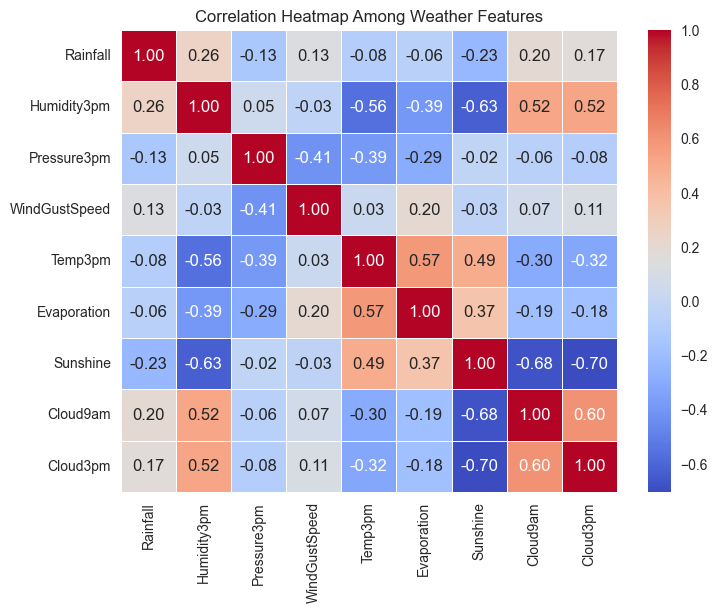

In [34]:
import seaborn as sns
plt.figure(figsize=(8, 6))

# Correlation matrix
corr_matrix = weather_data[weather_features].corr()

# Plot heatmap
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap Among Weather Features')
plt.show()


In [35]:
## checking the data fraame  
weather_data

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow,Month,Year,RainTomorrow_enc
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No,12,2008,0
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No,12,2008,0
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No,12,2008,0
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No,12,2008,0
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No,12,2008,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142188,2017-06-20,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,No,0.0,No,6,2017,0
142189,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,0.0,No,6,2017,0
142190,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,0.0,No,6,2017,0
142191,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,0.0,No,6,2017,0


In [36]:
# Find the average rainfall per location and sort in descending order
top_rainfall_locations = (
    weather_data.groupby('Location')['Rainfall']
        .mean()                # Calculate mean Rainfall per location
        .sort_values(ascending=False)  # Sort in descending order
        .reset_index()         # Reset index for cleaner output
)

# Display top 10 locations with the highest rainfall
print("Top 10 Locations with Highest Average Rainfall:")
print(top_rainfall_locations.head(10))


Top 10 Locations with Highest Average Rainfall:
       Location  Rainfall
0        Cairns  5.765317
1        Darwin  5.094048
2  CoffsHarbour  5.054592
3     GoldCoast  3.728933
4    Wollongong  3.589127
5   Williamtown  3.510985
6    Townsville  3.488603
7     NorahHead  3.382479
8        Sydney  3.330231
9   MountGinini  3.245241


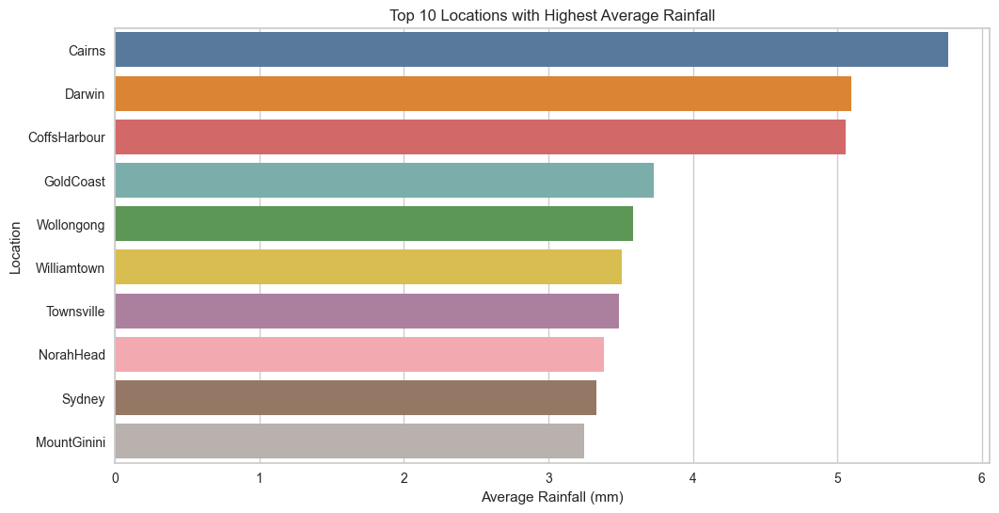

In [37]:

# Plot the top 10 locations
plt.figure(figsize=(12, 6))
sns.barplot(data=top_rainfall_locations.head(10), x='Rainfall', y='Location', palette=colors_list_qualitative)
plt.title('Top 10 Locations with Highest Average Rainfall')
plt.xlabel('Average Rainfall (mm)')
plt.ylabel('Location')
plt.show()


In [38]:
# Calculate the number of rainy days per location
rainy_days_per_location = (
    weather_data.query("Rainfall > 0")           # Filter only days with rainfall > 0
        .groupby('Location')['Rainfall']
        .count()                         # Count the number of rainy days
        .sort_values(ascending=False)    # Sort locations with most rainy days
        .reset_index(name='RainyDays')   # Reset index and rename column
)

# Display top 10 locations with the highest number of rainy days
print("Top 10 Locations with Most Rainy Days:")
print(rainy_days_per_location.head(10))


Top 10 Locations with Most Rainy Days:
        Location  RainyDays
0       Portland       1824
1   MountGambier       1589
2       Dartmoor       1570
3  NorfolkIsland       1549
4    Witchcliffe       1432
5        Walpole       1419
6         Hobart       1413
7       Ballarat       1359
8       Watsonia       1351
9         Albany       1339


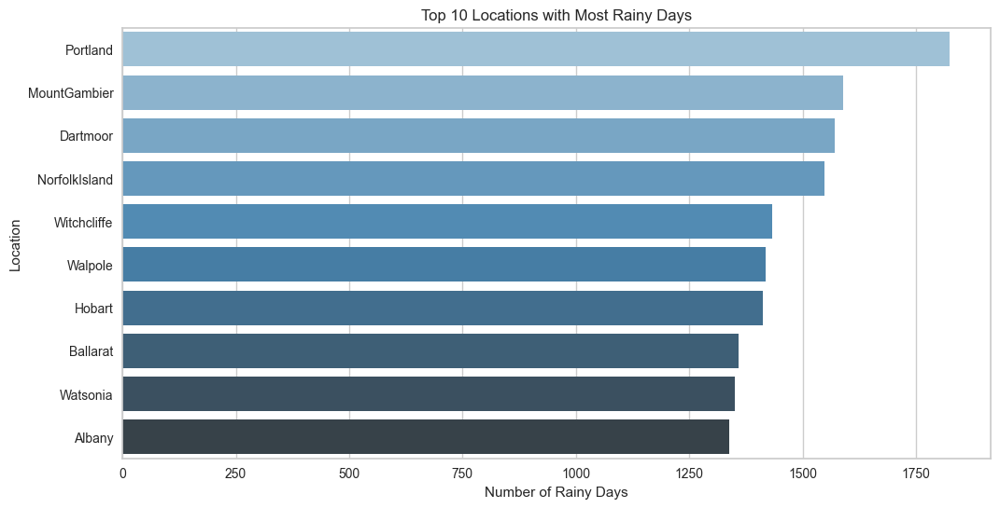

In [39]:
plt.figure(figsize=(12, 6))
sns.barplot(data=rainy_days_per_location.head(10), x='RainyDays', y='Location', palette='Blues_d')
plt.title('Top 10 Locations with Most Rainy Days')
plt.xlabel('Number of Rainy Days')
plt.ylabel('Location')
plt.show()


In [40]:
## checking for missing percentages  
weather_data.isnull().mean()*100

Date                 0.000000
Location             0.000000
MinTemp              0.447983
MaxTemp              0.226453
Rainfall             0.988797
Evaporation         42.789026
Sunshine            47.692924
WindGustDir          6.561504
WindGustSpeed        6.519308
WindDir9am           7.041838
WindDir3pm           2.656952
WindSpeed9am         0.948007
WindSpeed3pm         1.849599
Humidity9am          1.247600
Humidity3pm          2.538803
Pressure9am          9.855619
Pressure3pm          9.832411
Cloud9am            37.735332
Cloud3pm            40.152469
Temp9am              0.635756
Temp3pm              1.917113
RainToday            0.988797
RISK_MM              0.000000
RainTomorrow         0.000000
Month                0.000000
Year                 0.000000
RainTomorrow_enc     0.000000
dtype: float64

In [41]:
### Removing columns with a high ppercentage of missingness 
weather_data.drop(columns=['Evaporation','Sunshine','Cloud3pm','Cloud9am','RainTomorrow'],inplace=True)


In [42]:
## checking the data 
weather_data

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RISK_MM,Month,Year,RainTomorrow_enc
0,2008-12-01,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,0.0,12,2008,0
1,2008-12-02,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,0.0,12,2008,0
2,2008-12-03,Albury,12.9,25.7,0.0,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,0.0,12,2008,0
3,2008-12-04,Albury,9.2,28.0,0.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,1.0,12,2008,0
4,2008-12-05,Albury,17.5,32.3,1.0,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,0.2,12,2008,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142188,2017-06-20,Uluru,3.5,21.8,0.0,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,9.4,20.9,No,0.0,6,2017,0
142189,2017-06-21,Uluru,2.8,23.4,0.0,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,10.1,22.4,No,0.0,6,2017,0
142190,2017-06-22,Uluru,3.6,25.3,0.0,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,10.9,24.5,No,0.0,6,2017,0
142191,2017-06-23,Uluru,5.4,26.9,0.0,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,12.5,26.1,No,0.0,6,2017,0


### Feature Egineering

In [43]:
## Rainfall Indicator 
#- Heavy Rainfall today could impact rainfall Tommorrow 
weather_data['HighRainfallToday'] = weather_data['Rainfall'].apply(lambda x: 1 if x > 5 else 0)
## Temperature Ranges 
# - Difference btw Max temp and Min Temp could impact RainfallTommorow where Large flauctions in rainfall could impact Rainfall Tommorrow 
weather_data['TempRange'] = weather_data['MaxTemp'] - weather_data['MinTemp']
#  Humidity Interaction
# - Changes in humidity levels during the day can influence rainfall patterns
weather_data['HumidityDifference'] = weather_data['Humidity9am'] - weather_data['Humidity3pm']
# Rolling Rainfall Aggregates
# -  Rolling sum of Rainfall for the last 2 days
# -  Recent rainfall can affect tomorrow’s weather
# Set 'Date' as the index if it's not alread


# - Seasonal Features
# -  Rainfall patterns are seasonal.
# weather_data['Month'] = pd.to_datetime(weather_data['Date']).dt.month
weather_data['Season'] = weather_data['Month'].apply(lambda x: 'Summer' if x in [12, 1, 2] else 
                                              'Autumn' if x in [3, 4, 5] else 
                                              'Winter' if x in [6, 7, 8] else 'Spring')
##  Wind Features 
# -  Average of WindSpeed9am and WindSpeed3pm.
# - : Average wind speed reflects air movement, which can influence rain.
weather_data['WindSpeedMean'] = (weather_data['WindSpeed9am'] + weather_data['WindSpeed3pm']) / 2

### Wind Direction Flags 
## - Flag if WindDir9am or WindDir3pm points to North directions.
# -  Wind direction impacts rainfall. 
weather_data['IsWinweather_dataromNorth'] = weather_data['WindDir9am'].isin(['N', 'NE', 'NW']).astype(int)
##  Interaction Features 
# - Multiplying  Humidity3pm with MaxTemp.
# -  Interaction between heat and humidity is critical for rain.
weather_data['Humidity_Temp_Interaction'] = weather_data['Humidity3pm'] * weather_data['MaxTemp']






In [44]:
weather_data.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'WindGustDir',
       'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am',
       'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am',
       'Pressure3pm', 'Temp9am', 'Temp3pm', 'RainToday', 'RISK_MM', 'Month',
       'Year', 'RainTomorrow_enc', 'HighRainfallToday', 'TempRange',
       'HumidityDifference', 'Season', 'WindSpeedMean',
       'IsWinweather_dataromNorth', 'Humidity_Temp_Interaction'],
      dtype='object')

In [45]:
weather_data

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RISK_MM,Month,Year,RainTomorrow_enc,HighRainfallToday,TempRange,HumidityDifference,Season,WindSpeedMean,IsWinweather_dataromNorth,Humidity_Temp_Interaction
0,2008-12-01,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,0.0,12,2008,0,0,9.5,49.0,Summer,22.0,0,503.8
1,2008-12-02,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,0.0,12,2008,0,0,17.7,19.0,Summer,13.0,0,627.5
2,2008-12-03,Albury,12.9,25.7,0.0,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,0.0,12,2008,0,0,12.8,8.0,Summer,22.5,0,771.0
3,2008-12-04,Albury,9.2,28.0,0.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,1.0,12,2008,0,0,18.8,29.0,Summer,10.0,0,448.0
4,2008-12-05,Albury,17.5,32.3,1.0,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,0.2,12,2008,0,0,14.8,49.0,Summer,13.5,0,1065.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142188,2017-06-20,Uluru,3.5,21.8,0.0,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,9.4,20.9,No,0.0,6,2017,0,0,18.3,32.0,Winter,14.0,0,588.6
142189,2017-06-21,Uluru,2.8,23.4,0.0,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,10.1,22.4,No,0.0,6,2017,0,0,20.6,27.0,Winter,12.0,0,561.6
142190,2017-06-22,Uluru,3.6,25.3,0.0,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,10.9,24.5,No,0.0,6,2017,0,0,21.7,35.0,Winter,11.0,0,531.3
142191,2017-06-23,Uluru,5.4,26.9,0.0,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,12.5,26.1,No,0.0,6,2017,0,0,21.5,29.0,Winter,9.0,0,645.6


In [46]:
# Step 1: Sort the DataFrame by the 'Date' column
weather_data = weather_data.sort_values(by='Date')

# Step 2: Set the 'Date' column as the index
weather_data = weather_data.set_index('Date')

# Step 3: Verify the index
print(weather_data.index)  # Should show DatetimeIndex


DatetimeIndex(['2007-11-01', '2007-11-02', '2007-11-03', '2007-11-04',
               '2007-11-05', '2007-11-06', '2007-11-07', '2007-11-08',
               '2007-11-09', '2007-11-10',
               ...
               '2017-06-25', '2017-06-25', '2017-06-25', '2017-06-25',
               '2017-06-25', '2017-06-25', '2017-06-25', '2017-06-25',
               '2017-06-25', '2017-06-25'],
              dtype='datetime64[ns]', name='Date', length=142193, freq=None)


In [47]:
print(weather_data.index)


DatetimeIndex(['2007-11-01', '2007-11-02', '2007-11-03', '2007-11-04',
               '2007-11-05', '2007-11-06', '2007-11-07', '2007-11-08',
               '2007-11-09', '2007-11-10',
               ...
               '2017-06-25', '2017-06-25', '2017-06-25', '2017-06-25',
               '2017-06-25', '2017-06-25', '2017-06-25', '2017-06-25',
               '2017-06-25', '2017-06-25'],
              dtype='datetime64[ns]', name='Date', length=142193, freq=None)


In [48]:
weather_data = weather_data[~weather_data.index.duplicated(keep='first')]


In [49]:
print(weather_data.index)  # Confirm no duplicates remain


DatetimeIndex(['2007-11-01', '2007-11-02', '2007-11-03', '2007-11-04',
               '2007-11-05', '2007-11-06', '2007-11-07', '2007-11-08',
               '2007-11-09', '2007-11-10',
               ...
               '2017-06-16', '2017-06-17', '2017-06-18', '2017-06-19',
               '2017-06-20', '2017-06-21', '2017-06-22', '2017-06-23',
               '2017-06-24', '2017-06-25'],
              dtype='datetime64[ns]', name='Date', length=3436, freq=None)


In [50]:

# Rolling average calculations for meaningful timeframes
weather_data['Rainfall_Weekly'] = weather_data['Rainfall'].rolling(window='7D').mean()
weather_data['Rainfall_Monthly'] = weather_data['Rainfall'].rolling(window='30D').mean()
weather_data['Rainfall_Quarterly'] = weather_data['Rainfall'].rolling(window='90D').mean()
weather_data['Rainfall_Yearly'] = weather_data['Rainfall'].rolling(window='365D').mean()
weather_data['Rainfall_2Years'] = weather_data['Rainfall'].rolling(window='730D').mean()
## -  Create a lag feature to reflect yesterday’s rainfall.
weather_data['Rainfall_Lag1'] = weather_data['Rainfall'].shift(freq='1D')
##  Previous Day Rainfall 
# -  Flag if it rained yesterday (Rainfall > 1 mm).
# -  Rainfall persistence often happens across days
weather_data['RainYesterday'] = weather_data['Rainfall'].shift(freq='1D').apply(lambda x: 1 if x > 1 else 0)

In [51]:
### printing the data frame 
weather_data.head()

,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RISK_MM,Month,Year,RainTomorrow_enc,HighRainfallToday,TempRange,HumidityDifference,Season,WindSpeedMean,IsWinweather_dataromNorth,Humidity_Temp_Interaction,Rainfall_Weekly,Rainfall_Monthly,Rainfall_Quarterly,Rainfall_Yearly,Rainfall_2Years,Rainfall_Lag1,RainYesterday
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-11-01,Canberra,8.0,24.3,0.0,NW,30.0,SW,NW,6.0,20.0,68.0,29.0,1019.7,1015.0,14.4,23.6,No,3.6,11,2007,1,0,16.3,39.0,Spring,13.0,0,704.7,0.00,0.00,0.00,0.00,0.00,NaN,NaN
2007-11-02,Canberra,14.0,26.9,3.6,ENE,39.0,E,W,4.0,17.0,80.0,36.0,1012.4,1008.4,17.5,25.7,Yes,3.6,11,2007,1,0,12.9,44.0,Spring,10.5,0,968.4,1.80,1.80,1.80,1.80,1.80,0.0,0.0
2007-11-03,Canberra,13.7,23.4,3.6,NW,85.0,N,NNE,6.0,6.0,82.0,69.0,1009.5,1007.2,15.4,20.2,Yes,39.8,11,2007,1,0,9.7,13.0,Spring,6.0,1,1614.6,2.40,2.40,2.40,2.40,2.40,3.6,1.0
2007-11-04,Canberra,13.3,15.5,39.8,NW,54.0,WNW,W,30.0,24.0,62.0,56.0,1005.5,1007.0,13.5,14.1,Yes,2.8,11,2007,1,1,2.2,6.0,Spring,27.0,0,868.0,11.75,11.75,11.75,11.75,11.75,3.6,1.0
2007-11-05,Canberra,7.6,16.1,2.8,SSE,50.0,SSE,ESE,20.0,28.0,68.0,49.0,1018.3,1018.5,11.1,15.4,Yes,0.0,11,2007,0,0,8.5,19.0,Spring,24.0,0,788.9,9.96,9.96,9.96,9.96,9.96,39.8,1.0


In [52]:
## checking for the shape of the data 
weather_data.shape

(3436, 35)

In [53]:
## checking for missing values 
weather_data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3436 entries, 2007-11-01 to 2017-06-25
Data columns (total 35 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Location                   3436 non-null   object 
 1   MinTemp                    3416 non-null   float64
 2   MaxTemp                    3427 non-null   float64
 3   Rainfall                   3403 non-null   float64
 4   WindGustDir                3174 non-null   object 
 5   WindGustSpeed              3176 non-null   float64
 6   WindDir9am                 3195 non-null   object 
 7   WindDir3pm                 3367 non-null   object 
 8   WindSpeed9am               3403 non-null   float64
 9   WindSpeed3pm               3387 non-null   float64
 10  Humidity9am                3395 non-null   float64
 11  Humidity3pm                3363 non-null   float64
 12  Pressure9am                3121 non-null   float64
 13  Pressure3pm                312

In [54]:
weather_data['RainToday_encoded'] = weather_data['RainToday'].apply(lambda x: 1 if x =='Yes' else 0)

In [55]:
## checking for categorical features 
categorical_feeatures = weather_data.select_dtypes(include=['object','category'])

In [56]:
## checking for the columns 
categorical_feeatures.columns

Index(['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday',
       'Season'],
      dtype='object')

In [57]:
##checking for numerical features 
numerical_features_df = weather_data.select_dtypes(include=['int32','float64','int64'])
## print columns 
print(numerical_features_df.columns)


Index(['MinTemp', 'MaxTemp', 'Rainfall', 'WindGustSpeed', 'WindSpeed9am',
       'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am',
       'Pressure3pm', 'Temp9am', 'Temp3pm', 'RISK_MM', 'Month', 'Year',
       'RainTomorrow_enc', 'HighRainfallToday', 'TempRange',
       'HumidityDifference', 'WindSpeedMean', 'IsWinweather_dataromNorth',
       'Humidity_Temp_Interaction', 'Rainfall_Weekly', 'Rainfall_Monthly',
       'Rainfall_Quarterly', 'Rainfall_Yearly', 'Rainfall_2Years',
       'Rainfall_Lag1', 'RainYesterday', 'RainToday_encoded'],
      dtype='object')


In [58]:
numerical_features_df

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RISK_MM,Month,Year,RainTomorrow_enc,HighRainfallToday,TempRange,HumidityDifference,WindSpeedMean,IsWinweather_dataromNorth,Humidity_Temp_Interaction,Rainfall_Weekly,Rainfall_Monthly,Rainfall_Quarterly,Rainfall_Yearly,Rainfall_2Years,Rainfall_Lag1,RainYesterday,RainToday_encoded
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-11-01,8.0,24.3,0.0,30.0,6.0,20.0,68.0,29.0,1019.7,1015.0,14.4,23.6,3.6,11,2007,1,0,16.3,39.0,13.0,0,704.7,0.000000,0.00,0.000000,0.000000,0.000000,NaN,NaN,0
2007-11-02,14.0,26.9,3.6,39.0,4.0,17.0,80.0,36.0,1012.4,1008.4,17.5,25.7,3.6,11,2007,1,0,12.9,44.0,10.5,0,968.4,1.800000,1.80,1.800000,1.800000,1.800000,0.0,0.0,1
2007-11-03,13.7,23.4,3.6,85.0,6.0,6.0,82.0,69.0,1009.5,1007.2,15.4,20.2,39.8,11,2007,1,0,9.7,13.0,6.0,1,1614.6,2.400000,2.40,2.400000,2.400000,2.400000,3.6,1.0,1
2007-11-04,13.3,15.5,39.8,54.0,30.0,24.0,62.0,56.0,1005.5,1007.0,13.5,14.1,2.8,11,2007,1,1,2.2,6.0,27.0,0,868.0,11.750000,11.75,11.750000,11.750000,11.750000,3.6,1.0,1
2007-11-05,7.6,16.1,2.8,50.0,20.0,28.0,68.0,49.0,1018.3,1018.5,11.1,15.4,0.0,11,2007,0,0,8.5,19.0,24.0,0,788.9,9.960000,9.96,9.960000,9.960000,9.960000,39.8,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-06-21,5.2,13.6,0.0,20.0,0.0,7.0,100.0,83.0,1028.9,1028.5,9.8,12.7,0.4,6,2017,0,0,8.4,17.0,3.5,0,1128.8,0.085714,0.68,0.807865,1.682692,1.826099,0.2,0.0,0
2017-06-22,-0.5,16.7,0.0,24.0,6.0,13.0,99.0,51.0,1028.2,1024.4,3.8,16.1,0.0,6,2017,0,0,17.2,48.0,9.5,0,851.7,0.057143,0.68,0.805618,1.673352,1.826099,0.0,0.0,0
2017-06-23,4.1,27.8,0.0,19.0,7.0,6.0,45.0,18.0,1021.4,1017.3,15.1,27.2,0.0,6,2017,0,0,23.7,27.0,6.5,1,500.4,0.057143,0.68,0.803371,1.673352,1.825549,0.0,0.0,0


In [59]:
# import pandas as pd
# import numpy as np
# from sklearn.experimental import enable_iterative_imputer  # noqa
# from sklearn.impute import IterativeImputer
# from xgboost import XGBRegressor



# # Step 1: Initialize the Iterative Imputer with XGBoost as the estimator
# imputer = IterativeImputer(
#     estimator=XGBRegressor(objective='reg:squarederror', n_estimators=100, max_depth=5),
#     max_iter=10,  # Number of iterations to refine imputations
#     initial_strategy='mean',  # Starting strategy for missing values
#     random_state=42
# )

# # Step 2: Fit and transform the DataFrame to impute missing values
# numerical_df_imputed = pd.DataFrame(
#     imputer.fit_transform(numerical_features_df),
#     columns=numerical_features_df.columns
# )

# # Step 3: Ensure the imputed DataFrame retains approximately 80% of the original data
# # This is automatically achieved since IterativeImputer imputes based on relationships in the data
# print(numerical_df_imputed)


In [60]:
categorical_feeatures

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,Season
Date,,,,,,
2007-11-01,Canberra,NW,SW,NW,No,Spring
2007-11-02,Canberra,ENE,E,W,Yes,Spring
2007-11-03,Canberra,NW,N,NNE,Yes,Spring
2007-11-04,Canberra,NW,WNW,W,Yes,Spring
2007-11-05,Canberra,SSE,SSE,ESE,Yes,Spring
...,...,...,...,...,...,...
2017-06-21,Watsonia,N,NaN,WSW,No,Winter
2017-06-22,Mildura,NNE,SE,NNE,No,Winter
2017-06-23,AliceSprings,N,NE,N,No,Winter


In [61]:
## checking for the percentage of numerical missing values 
categorical_feeatures.isnull().mean()*100

Location       0.000000
WindGustDir    7.625146
WindDir9am     7.013970
WindDir3pm     2.008149
RainToday      0.960419
Season         0.000000
dtype: float64

In [62]:
## remove the Rian Today from the categoric feature
categorical_feeatures.drop(columns=['RainToday'])

,Location,WindGustDir,WindDir9am,WindDir3pm,Season
Date,,,,,
2007-11-01,Canberra,NW,SW,NW,Spring
2007-11-02,Canberra,ENE,E,W,Spring
2007-11-03,Canberra,NW,N,NNE,Spring
2007-11-04,Canberra,NW,WNW,W,Spring
2007-11-05,Canberra,SSE,SSE,ESE,Spring
...,...,...,...,...,...
2017-06-21,Watsonia,N,NaN,WSW,Winter
2017-06-22,Mildura,NNE,SE,NNE,Winter
2017-06-23,AliceSprings,N,NE,N,Winter


In [63]:
categorical_feeatures_df = pd.get_dummies(data=categorical_feeatures , drop_first=True,dtype=int)
print(categorical_feeatures_df)

            Location_Albany  Location_Albury  Location_AliceSprings  \
Date                                                                  
2007-11-01                0                0                      0   
2007-11-02                0                0                      0   
2007-11-03                0                0                      0   
2007-11-04                0                0                      0   
2007-11-05                0                0                      0   
...                     ...              ...                    ...   
2017-06-21                0                0                      0   
2017-06-22                0                0                      0   
2017-06-23                0                0                      1   
2017-06-24                0                0                      0   
2017-06-25                0                0                      0   

            Location_BadgerysCreek  Location_Ballarat  Location_Bendigo  \
D

In [64]:
categorical_feeatures_df.isnull().sum().sum()

0

In [65]:
## combining the dataframe  
final__df =  pd.concat([numerical_features_df , categorical_feeatures_df],axis=1)


In [66]:
final__df

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RISK_MM,Month,Year,RainTomorrow_enc,HighRainfallToday,TempRange,HumidityDifference,WindSpeedMean,IsWinweather_dataromNorth,Humidity_Temp_Interaction,Rainfall_Weekly,Rainfall_Monthly,Rainfall_Quarterly,Rainfall_Yearly,Rainfall_2Years,Rainfall_Lag1,RainYesterday,RainToday_encoded,Location_Albany,Location_Albury,Location_AliceSprings,Location_BadgerysCreek,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,Location_MountGinini,Location_Newcastle,Location_Nhil,Location_NorahHead,Location_NorfolkIsland,Location_Nuriootpa,Location_PearceRAAF,Location_Penrith,Location_Perth,Location_PerthAirport,Location_Portland,Location_Richmond,Location_Sale,Location_SalmonGums,Location_Sydney,Location_SydneyAirport,Location_Townsville,Location_Tuggeranong,Location_Uluru,Location_WaggaWagga,Location_Walpole,Location_Watsonia,Location_Williamtown,Location_Witchcliffe,Location_Wollongong,Location_Woomera,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_Yes,Season_Spring,Season_Summer,Season_Winter
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-11-01,8.0,24.3,0.0,30.0,6.0,20.0,68.0,29.0,1019.7,1015.0,14.4,23.6,3.6,11,2007,1,0,16.3,39.0,13.0,0,704.7,0.000000,0.00,0.000000,0.000000,0.000000,NaN,NaN,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
2007-11-02,14.0,26.9,3.6,39.0,4.0,17.0,80.0,36.0,1012.4,1008.4,17.5,25.7,3.6,11,2007,1,0,12.9,44.0,10.5,0,968.4,1.800000,1.80,1.800000,1.800000,1.800000,0.0,0.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0
2007-11-03,13.7,23.4,3.6,85.0,6.0,6.0,82.0,69.0,1009.5,1007.2,15.4,20.2,39.8,11,2007,1,0,9.7,13.0,6.0,1,1614.6,2.400000,2.40,2.400000,2.400000,2.400000,3.6,1.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0
2007-11-04,13.3,15.5,39.8,54.0,30.0,24.0,62.0,56.0,1005.5,1007.0,13.5,14.1,2.8,11,2007,1,1,2.2,6.0,27.0,0,868.0,11.750000,11.75,11.750000,11.750000,11.750000,3.6,1.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0
2007-11-05,7.6,16.1,2.8,50.0,20.0,28.0,68.0,49.0,1018.3,1018.5,11.1,15.4,0.0,11,2007,0,0,8.5,19.0,24.0,0,788.9,9.960000,9.96,9.960000,9.960000,9.960000,39.8,1.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [67]:
### missing values percentage 
final__df.isnull().mean()*100

MinTemp           0.582072
MaxTemp           0.261932
Rainfall          0.960419
WindGustSpeed     7.566938
WindSpeed9am      0.960419
                    ...   
WindDir3pm_WSW    0.000000
RainToday_Yes     0.000000
Season_Spring     0.000000
Season_Summer     0.000000
Season_Winter     0.000000
Length: 127, dtype: float64

In [68]:
x = final__df.drop(columns = 'RainTomorrow_enc')
y = final__df['RainTomorrow_enc']

In [69]:
x.head()

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RISK_MM,Month,Year,HighRainfallToday,TempRange,HumidityDifference,WindSpeedMean,IsWinweather_dataromNorth,Humidity_Temp_Interaction,Rainfall_Weekly,Rainfall_Monthly,Rainfall_Quarterly,Rainfall_Yearly,Rainfall_2Years,Rainfall_Lag1,RainYesterday,RainToday_encoded,Location_Albany,Location_Albury,Location_AliceSprings,Location_BadgerysCreek,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,Location_MountGinini,Location_Newcastle,Location_Nhil,Location_NorahHead,Location_NorfolkIsland,Location_Nuriootpa,Location_PearceRAAF,Location_Penrith,Location_Perth,Location_PerthAirport,Location_Portland,Location_Richmond,Location_Sale,Location_SalmonGums,Location_Sydney,Location_SydneyAirport,Location_Townsville,Location_Tuggeranong,Location_Uluru,Location_WaggaWagga,Location_Walpole,Location_Watsonia,Location_Williamtown,Location_Witchcliffe,Location_Wollongong,Location_Woomera,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_Yes,Season_Spring,Season_Summer,Season_Winter
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-11-01,8.0,24.3,0.0,30.0,6.0,20.0,68.0,29.0,1019.7,1015.0,14.4,23.6,3.6,11,2007,0,16.3,39.0,13.0,0,704.7,0.00,0.00,0.00,0.00,0.00,NaN,NaN,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
2007-11-02,14.0,26.9,3.6,39.0,4.0,17.0,80.0,36.0,1012.4,1008.4,17.5,25.7,3.6,11,2007,0,12.9,44.0,10.5,0,968.4,1.80,1.80,1.80,1.80,1.80,0.0,0.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0
2007-11-03,13.7,23.4,3.6,85.0,6.0,6.0,82.0,69.0,1009.5,1007.2,15.4,20.2,39.8,11,2007,0,9.7,13.0,6.0,1,1614.6,2.40,2.40,2.40,2.40,2.40,3.6,1.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0
2007-11-04,13.3,15.5,39.8,54.0,30.0,24.0,62.0,56.0,1005.5,1007.0,13.5,14.1,2.8,11,2007,1,2.2,6.0,27.0,0,868.0,11.75,11.75,11.75,11.75,11.75,3.6,1.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0
2007-11-05,7.6,16.1,2.8,50.0,20.0,28.0,68.0,49.0,1018.3,1018.5,11.1,15.4,0.0,11,2007,0,8.5,19.0,24.0,0,788.9,9.96,9.96,9.96,9.96,9.96,39.8,1.0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0


In [70]:
y

Date
2007-11-01    1
2007-11-02    1
2007-11-03    1
2007-11-04    1
2007-11-05    0
             ..
2017-06-21    0
2017-06-22    0
2017-06-23    0
2017-06-24    0
2017-06-25    0
Name: RainTomorrow_enc, Length: 3436, dtype: int64

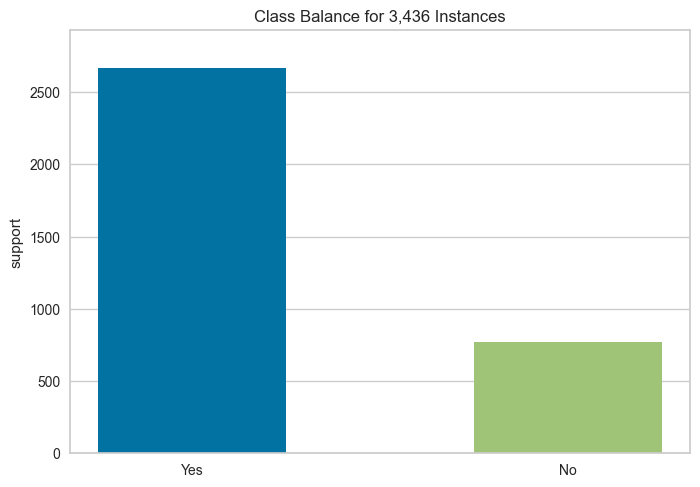

<Axes: title={'center': 'Class Balance for 3,436 Instances'}, ylabel='support'>

In [71]:
## checking the distribution of the y value   
from yellowbrick.target import class_balance
visualizer = class_balance(y ,labels=['Yes','No'])
visualizer.show()

In [74]:
missing_percentage = x.isnull().sum().sum() / (x.shape[0] * x.shape[1]) * 100
print(f"Total Percentage of Missingness: {missing_percentage:.2f}%")


Total Percentage of Missingness: 0.36%


In [75]:
x.fillna(x.mean(), inplace=True) 

In [76]:
missing_percentage = x.isnull().sum().sum() / (x.shape[0] * x.shape[1]) * 100
print(f"Total Percentage of Missingness: {missing_percentage:.2f}%")

Total Percentage of Missingness: 0.00%


### Data Splitting 

In [109]:
x_train , x_test , y_train , y_test = train_test_split(x , y , test_size=0.2, random_state=42,stratify=y)
## checking for the shapes after distribution 
x_train.shape , y_train.shape , x_test.shape ,y_test.shape 

((2748, 126), (2748,), (688, 126), (688,))

In [110]:
# Scaling
scaler = StandardScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

### MODEL BUILDING 

#### Logistic Regression

In [111]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(class_weight='balanced')
model.fit(x_train_scaled, y_train)


LogisticRegression(class_weight='balanced')

In [112]:
## making predictions 
y_pred =   model.predict(x_test)
## calling out thee accuracy attribute 
print(f'The Accuracy for logistic Regression is {accuracy_score(y_pred , y_test)}')

The Accuracy for logistic Regression is 0.7819767441860465


In [113]:
### clafrom sklearn.metrics import classification_report
from sklearn.metrics import classification_report
print('Classiffication Report for Logistic Regression')
print()
print(classification_report(y_pred , y_test))


Classiffication Report for Logistic Regression

              precision    recall  f1-score   support

           0       1.00      0.78      0.88       684
           1       0.03      1.00      0.05         4

    accuracy                           0.78       688
   macro avg       0.51      0.89      0.46       688
weighted avg       0.99      0.78      0.87       688



In [114]:
## The reciever operating chararistics
from sklearn.metrics import roc_curve, roc_auc_score
# Predict probabilities for the positive class
y_pred_proba = model.predict_proba(x_test)[:, 1]

In [115]:
# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test, y_pred_proba)
print(f"ROC AUC Score: {roc_auc:.2f}")

ROC AUC Score: 0.47


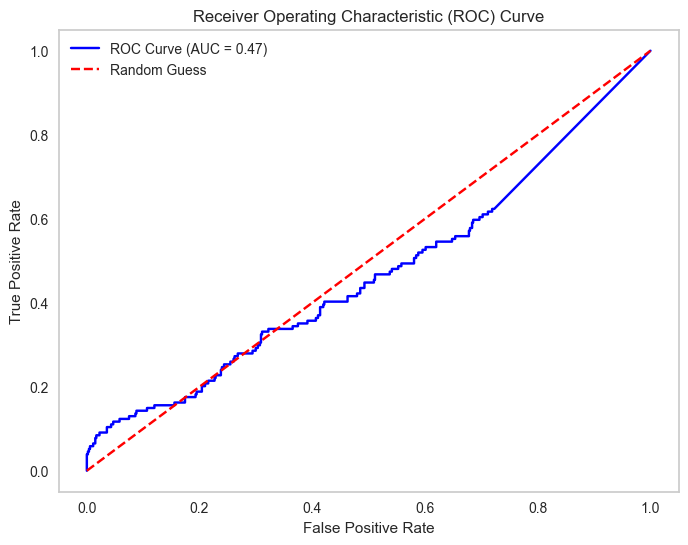

In [116]:


# Compute the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f"ROC Curve (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], color='red', linestyle='--', label="Random Guess")
plt.title("Receiver Operating Characteristic (ROC) Curve")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.grid()
plt.show()

